In [ ]:
!pip install --upgrade "numpy==1.20.2" "scikit-learn==0.24.1"

Requirement already up-to-date: numpy==1.20.2 in /usr/local/lib/python3.7/dist-packages (1.20.2)
Requirement already up-to-date: scikit-learn==0.24.1 in /usr/local/lib/python3.7/dist-packages (0.24.1)


# Машинное обучение, ВМК МГУ

# Практическое задание 3. Обучение без учителя.

## Общая информация
Дата выдачи: 15.04.2021 23:59MSK

Мягкий дедлайн: 29.04.2021 23:59 MSK

Жёсткий дедлайн: 06.05.2021 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу (без учета бонусов) — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-03-Username.ipynb

Username — ваша фамилия на латинице

<p style="color:#de3815;font-size:25px;">
Напоминание об оформлении и выполнении ноутбука
</p>

* Все строчки должны быть выполнены. Нужно, чтобы output команды можно было увидеть, не запуская ячейки (кроме редких случаев, когда необходимо намеренно скрыть ненужный output, про такие случаи желательно писать пояснения в тексте). **В противном случае -1 балл**
* При оформлении ДЗ нужно пользоваться данным файлом в качестве шаблона. Не нужно удалять и видоизменять написанный код и текст, если явно не указана такая возможность. **В противном случае -1 балл**
* В anytask обязательно нужно прикреплять отдельно файл с расширением ipynb (не в архиве, а именно отдельно). Если необходимо отправить еще какие-то файлы, то вынесите их в отдельный архив (если файлов много) и пришлите. **В противном случае -0.5 балла**
---
* Пишите, пожалуйста, выводы и ответы на вопросы в текстовых ячейках/при помощи print в коде. При их отсутствии мы не можем понять, сделали ли вы задание и понимаете, что происходит, и **поэтому будем снижать баллы**
* Если алгоритм не сказано реализовывать явно, его всегда можно импортировать из библиотеки.
---
* Про графики. _Штрафы будут применяться к каждому результату команды отображения графика (plt.show() и др. аналогичные). Исключением являются графики, генерируемые функциями каких-либо сторонних библиотек, если их нельзя кастомизировать_

    * должно быть название (plt.title) графика; **В противном случае &ndash; -0.05 балла**
    * на графиках должны быть подписаны оси (plt.xlabel, plt.ylabel); **В противном случае &ndash; -0.025 балла за каждую ось**
    * должны быть подписаны единицы измерения (если это возможно); **В противном случае &ndash; -0.025 балла за каждую ось**
    * все названия должны быть понятны любому человеку, знакомому с терминологией, без заглядывания в код; **В противном случае &ndash; -0.05 балла**
    * подписи тиков на осях не должны сливаться как на одной оси, так и между ними; **В противном случае &ndash; -0.025 балла за каждую ось**
    * если изображено несколько сущностей на одном холсте (например несколько функций), то необходима поясняющая легенда (plt.legend); **В противном случае &ndash; -0.05 балла**
    * все линии на графиках должны быть чётко видны (нет похожих цветов или цветов, сливающихся с фоном); **В противном случае &ndash; -0.05 балла**
    * если отображена величина, имеющая очевидный диапазон значений (например, проценты могут быть от 0 до 100), то желательно масштабировать ось на весь диапазон значений (исключением является случай, когда вам необходимо показать малое отличие, которое незаметно в таких масштабах);
    * графики должны быть не супер-микро и не супер-макро по размерам, так, чтобы можно было увидеть все, что нужно.
    * при необходимости улучшения наглядности графиков, можно пользоваться логарифмической шкалой по осям x/y.
    

### Нововведение!

* Для удобства поиска вопросов, на которые от вас просят ответа, мы пометили их знаком (?)
* Даем до +0.3 баллов за выдающиеся успехи по субъективному мнению проверяющих. Этот бонус не апеллируется

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



**Замечание:**
* seed менять нежелательно

In [ ]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

**Задание 0 (0.05 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму👺 (можно картинкой или мемом).

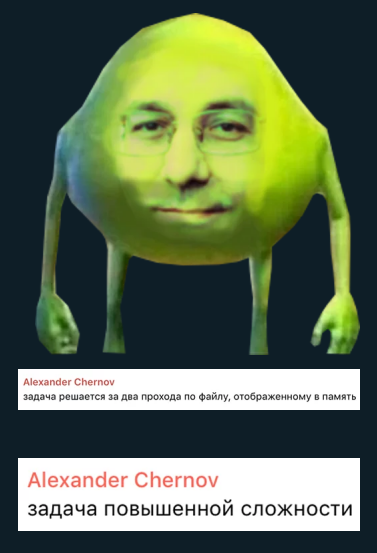

<font color=blue>Контесты — топ!</font>

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции/семинаре. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [ ]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        
        _, eigenvecs = np.linalg.eigh(np.diag(X.sum(axis=1)) - X)
        return eigenvecs[:, :self.n_components]

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [ ]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

**Замечание**
* Для возможности получения **полного балла** assert должны проходить

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

**Замечание**
* (?) Напишите, пожалуйста, откуда в итоге скачивали данные. 

<font color=blue>Данные скачаем по первой ссылке:</font>

In [ ]:
!wget -q https://data.mos.ru/opendata/download/60464/1/201 -O sobyanin.zip
!unzip -q sobyanin.zip
!mv 'City surface public transport stops.xlsx' 'transport.xlsx'

In [ ]:
data = pd.read_excel('transport.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN



Воспользуемся библиотекой `folium` для визуализации данных.

In [ ]:
import folium

map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map_)
map_

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [ ]:
from collections import defaultdict
from sklearn.metrics.pairwise import haversine_distances


def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    stop_routes = data['RouteNumbers_en'].str.findall('\w+')
    route_stops = defaultdict(list)
    for stop, routes in stop_routes.items():
        for route in routes:
            route_stops[route].append(stop)
    return dict(route_stops)

def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''

    route_sorted_stops = {}
    for route, stops in routes.items():
        lat_long = data.loc[stops, ['Latitude_WGS84_en', 'Longitude_WGS84_en']]
        pw = haversine_distances(np.deg2rad(lat_long))
        inner_idx = pw.sum(axis=1).argmax()
        sorted_stops = [lat_long.index[inner_idx]]
        pw[:, inner_idx] = np.inf
        while len(sorted_stops) != len(stops):
            inner_idx = pw[inner_idx].argmin()
            sorted_stops.append(lat_long.index[inner_idx])
            pw[:, inner_idx] = np.inf
        route_sorted_stops[route] = sorted_stops
    return route_sorted_stops


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''

    adj_mx = np.zeros((len(data), len(data)))
    for stops in sorted_routes.values():
        forward_ix = stops[:-1]
        backward_ix = stops[1:]
        adj_mx[forward_ix, backward_ix] += 1
        adj_mx[backward_ix, forward_ix] += 1
    return adj_mx

In [ ]:
%%time
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

CPU times: user 202 ms, sys: 463 µs, total: 203 ms
Wall time: 216 ms


Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [ ]:
map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map_)

map_

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [ ]:
from matplotlib.cm import get_cmap
from matplotlib.colors import to_hex

def draw_clustered_map(data, labels, noise_label=None):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    param noise_label: element from labels or None - will be colored in gray
    return: folium.Map - map with coloured clusters
    '''

    map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
    unique_labels = np.unique(labels)
    if noise_label is not None:
        unique_labels = unique_labels[unique_labels != noise_label]
    cm = get_cmap('gist_rainbow')
    colors = [to_hex(c) for c in cm(np.linspace(0, 1, len(unique_labels)))]
    color_picker = dict(zip(unique_labels, colors))
    if noise_label is not None:
        color_picker[noise_label] = 'gray'
    iter_ = zip(data['Latitude_WGS84_en'], data['Longitude_WGS84_en'], labels)
    for lat, long, label in iter_: 
        folium.CircleMarker(
            [lat, long],
            radius=5,
            fill=True,
            color=color_picker[label],
            tooltip=label
        ).add_to(map_)
    return map_

**Задание 1.4 (1.5 балла)**. 

* **(0.25 балла)** Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. В этом пункте используйте дефолтные параметры.
* **(0.25 балла)** Визуализируйте результат кластеризации из предыдущего пункта с помощью функции `draw_clustered_map`.
* **(0.75 балла)** А теперь подберите параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации. Визуализируйте полученные результаты для всех трех алгоритмов на *оптимальных параметрах*
* (?) Проинтерпретируйте полученные результаты.
 * **(0.1 балла)** Чем отличаются разбиения на кластеры, получаемые разными алгоритмами?
 * **(0.1 балла)** Какие плюсы и минусы есть у каждого алгоритма?
 * **(0.05 балла)** Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).
* Обращайте внимание на баланс объектов в кластерах.

### <font color=blue>Дефолтные параметры</font>

In [ ]:
from sklearn.cluster import KMeans, DBSCAN

X = data[['Longitude_WGS84_en', 'Latitude_WGS84_en']]
y = KMeans().fit_predict(X)
draw_clustered_map(data, y)

In [ ]:
from sklearn.cluster import DBSCAN

y = DBSCAN().fit_predict(X)
draw_clustered_map(data, y)

In [ ]:
y = GraphClustering().fit_predict(adjacency_matrix)
draw_clustered_map(data, y)

### <font color=blue>Разумные параметры</font>

In [ ]:
import matplotlib.pyplot as plt
from IPython.display import set_matplotlib_formats
from cycler import cycler

plt.rc('axes', axisbelow=True, grid=True)
plt.rc('grid', c='grey', ls=':')
plt.rc('font', family='serif')
plt.rc('axes', prop_cycle=cycler(color='bmrcgyk'))
plt.rc('image', cmap='gist_rainbow')
set_matplotlib_formats('svg')

<font color=blue>Найдем оптимальное число кластеров с помощью метода силуэтов. Он основан на эвристике: мы хотим, чтобы объект был как можно ближе к другим объектам своего кластера и как можно дальше от объектов чужого кластера. Соответствующий коэффициент силуэта (частное) считается для каждого объекта, а затем усредняется по выборке. Посмотрим, как данная метрика зависит от числа кластеров.</font>

In [ ]:
from tqdm import tqdm
from sklearn.metrics import silhouette_score

n_clusters_vals = np.arange(2, 1002, 10)
silhouettes = []
for n_clusters in tqdm(n_clusters_vals):
    y = KMeans(n_clusters=n_clusters).fit_predict(X)
    silhouettes.append(silhouette_score(X, y))

100%|██████████| 100/100 [03:43<00:00,  2.23s/it]


<font color=blue>Визуализируем результат:</font>

Optimal number of kmeans-clusters w.r.t silhouettes: 442


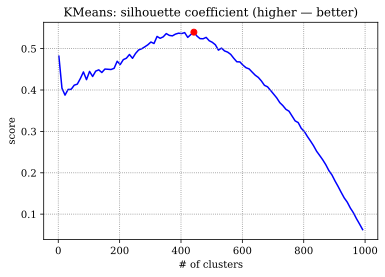

In [ ]:
plt.title(f'KMeans: silhouette coefficient (higher — better)')
idxmax = np.argmax(silhouettes)
n_best_km = n_clusters_vals[idxmax]
plt.plot(n_clusters_vals, silhouettes, zorder=0)
plt.scatter(n_best_km, silhouettes[idxmax], c='r', zorder=1)
plt.xlabel('# of clusters')
plt.ylabel('score')
print('Optimal number of kmeans-clusters w.r.t silhouettes:',
      n_best_km)

In [ ]:
y = KMeans(n_clusters=n_best_km).fit_predict(X)
draw_clustered_map(data, y)

<font color=blue>О, с силуэтами вышел отстой. Всё, что нам нужно прямо сейчас — старый добрый метод локтя. </font>
1. <font color=blue>Посчитаем для каждого объекта квадрат расстояния до ближайшего центроида, просуммируем по выборке (полученная величина называется инерцией). Фактически внутри KMeans мы минимизируем эту величину. Найдем значение инерции для разного числа кластеров.</font>
2. <font color=blue>Среди полученных величин обнаружим «локоть» — точку, после которой увеличение числа кластеров уже не дает существенного улучшения.</font>

In [ ]:
inertias = []
n_clusters_vals = np.arange(1, 101)
for n_clusters in tqdm(n_clusters_vals):
    model = KMeans(n_clusters=n_clusters)
    y = model.fit_predict(X)
    inertias.append(model.inertia_)

100%|██████████| 100/100 [01:31<00:00,  1.10it/s]


<font color=blue>Осталось обнаружить «локоть» — учитывая эвристическую природу алгоритма, можно взять разные значения. Но попробуем воспользоваться <a href='https://github.com/arvkevi/kneed'>специальной библиотекой</a>.</font>

In [ ]:
!pip install kneed -q
from kneed import KneeLocator

elbow = KneeLocator(n_clusters_vals, inertias, curve='convex',
                   direction='decreasing').knee
print('Optimal number of kmeans-clusters w.r.t elbow method:',
      elbow)

Optimal number of kmeans-clusters w.r.t elbow method: 9


<font color=blue>Визуализируем:</font>

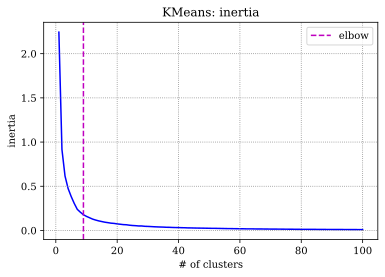

In [ ]:
plt.title(f'KMeans: inertia')
plt.plot(n_clusters_vals, inertias, zorder=0)
plt.xlabel('# of clusters')
plt.ylabel('inertia')
plt.axvline(x=elbow, c='m', linestyle='--', label='elbow')
plt.legend()

In [ ]:
y = KMeans(n_clusters=elbow).fit_predict(X)
draw_clustered_map(data, y)

<font color=blue>Забавно, что мы получили почти дефолтное значение внутри sklearn. Далее будем находить оптимальные гиперпараметры сразу по результату кластеризации.</font>

<font color=blue>Теперь подберем $\varepsilon$ для DBSCAN. Определимся с диапазоном. Слишком маленькие значения окрестности приведут к тому, что все объекты будут считаться шумовыми; а из-за слишком больших алгоритм всех отнесет к единственному кластеру.</font>

In [ ]:
from sklearn.cluster import DBSCAN

model = DBSCAN(eps=0.0001)
y = model.fit_predict(X)
print(f'With eps=0.0001 all objects become noise: {np.all(y == -1)}')
model = DBSCAN(eps=0.01)
y = model.fit_predict(X)
print(f'With eps=0.01 algorithm finds the only cluster: {np.all(y == 0)}')

With eps=0.0001 all objects become noise: True
With eps=0.01 algorithm finds the only cluster: True


<font color=blue>Значит, «неплохие» значения лежат в пределах данного диапазона. Попробуем построить несколько кластеризаций без карты и выбрать наиболее приемлемый вариант. (На графиках широта и долгота станут прямоугольными осями, но из-за маленькой области фрагмента это не критично).</font>

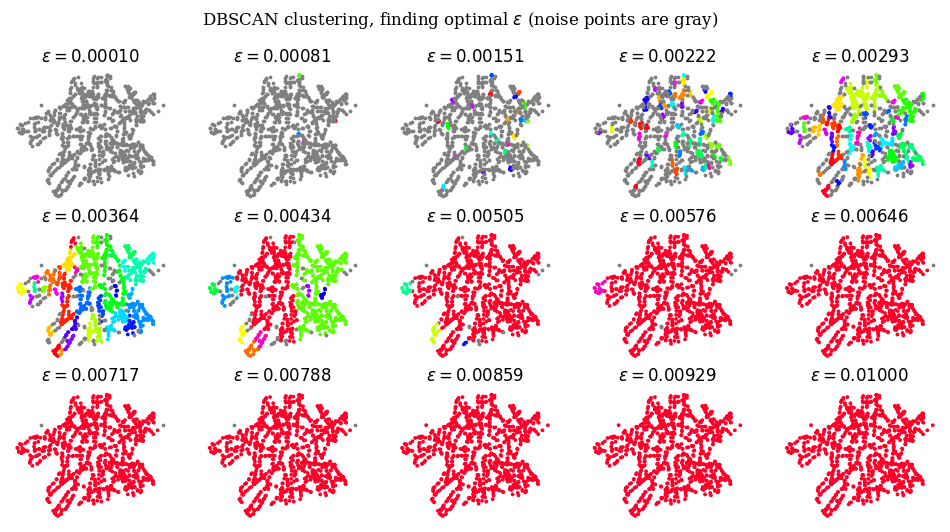

In [ ]:
set_matplotlib_formats('png')
epsilons = np.linspace(0.0001, 0.01, 15)
plt.figure(figsize=(12, 6), dpi=100)
plt.suptitle('DBSCAN clustering, finding optimal $\\varepsilon$ '
             '(noise points are gray)')
for i in range(3):
    for j in range(5):
        eps = epsilons[i * 5 + j]
        model = DBSCAN(eps=eps)
        y = model.fit_predict(X)
        plt.subplot(3, 5, i * 5 + j + 1)
        plt.scatter(X.iloc[y != -1, 0], X.iloc[y != -1, 1], c=y[y != -1], s=3)
        plt.scatter(X.iloc[y == -1, 0], X.iloc[y == -1, 1], c='gray', s=3)
        plt.axis('off')
        plt.title(r'$\varepsilon=' + f'{eps:.5f}$')

<font color=blue>Видно, что оптимальное значение между 0.003 и 0.004:</font>

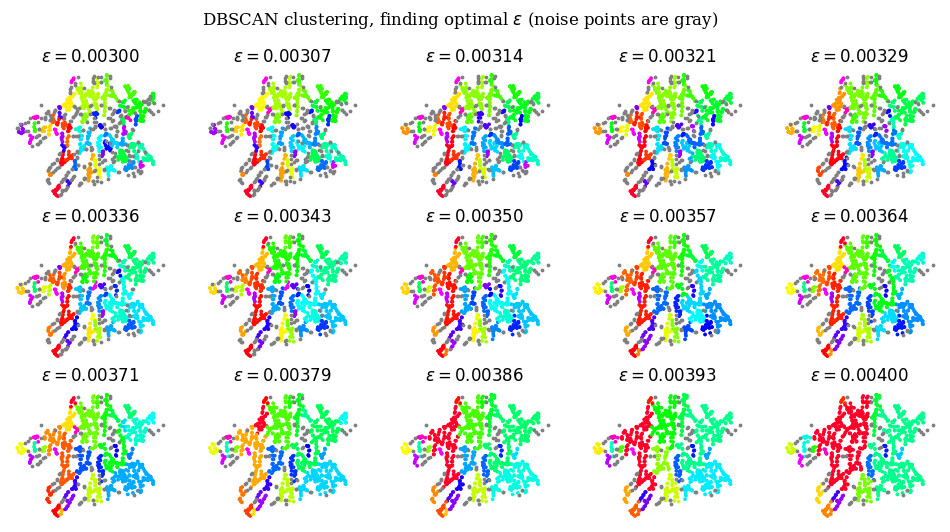

In [ ]:
epsilons = np.linspace(0.003, 0.004, 15)
plt.figure(figsize=(12, 6), dpi=100)
plt.suptitle('DBSCAN clustering, finding optimal $\\varepsilon$ '
             '(noise points are gray)')
for i in range(3):
    for j in range(5):
        eps = epsilons[i * 5 + j]
        model = DBSCAN(eps=eps)
        y = model.fit_predict(X)
        plt.subplot(3, 5, i * 5 + j + 1)
        plt.scatter(X.iloc[y != -1, 0], X.iloc[y != -1, 1], c=y[y != -1], s=3)
        plt.scatter(X.iloc[y == -1, 0], X.iloc[y == -1, 1], c='gray', s=3)
        plt.axis('off')
        plt.title(r'$\varepsilon=' + f'{eps:.5f}$')

<font color=blue>Оставим $\varepsilon=0.0035$ — в этом случае получается не очень много шумовых точек, а у кластеров получаются достаточно адекватные формы. По-прежнему серый цвет используем для визуализации шумовых точек:</font>

In [ ]:
y = DBSCAN(eps=0.0035).fit_predict(X)
draw_clustered_map(data, y, noise_label=-1)

<font color=blue>Наконец, посмотрим, с какими параметрами лучше всего работает спектральная кластеризация. Сначала определимся с числом кластеров, а затем выберем оптимальное число собственных векторов.</font>

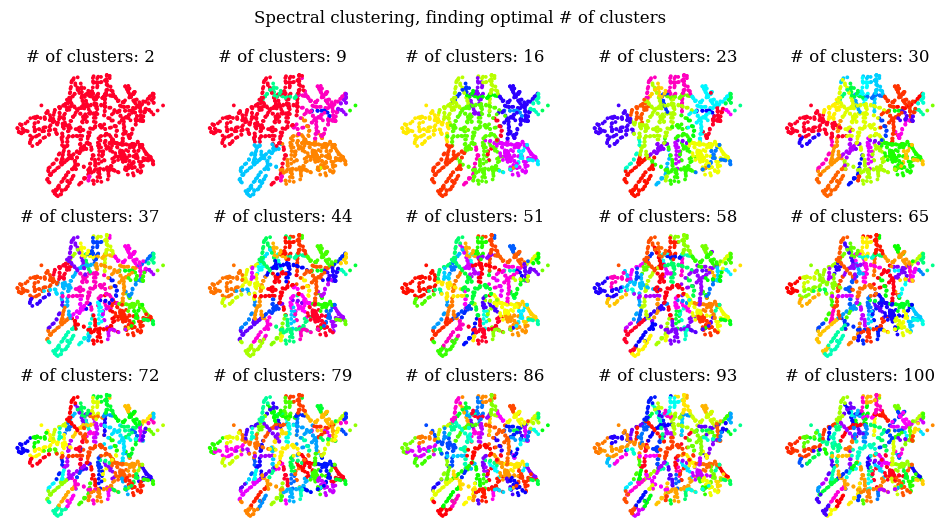

In [ ]:
n_clusters_vals = np.linspace(2, 100, 15, dtype=int)
plt.figure(figsize=(12, 6), dpi=100)
plt.suptitle('Spectral clustering, finding optimal # of clusters')
for i in range(3):
    for j in range(5):
        n_clusters = n_clusters_vals[i * 5 + j]
        model = GraphClustering(n_clusters=n_clusters)
        y = model.fit_predict(adjacency_matrix)
        plt.subplot(3, 5, i * 5 + j + 1)
        plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=y, s=3)
        plt.axis('off')
        plt.title(f'# of clusters: {n_clusters}')

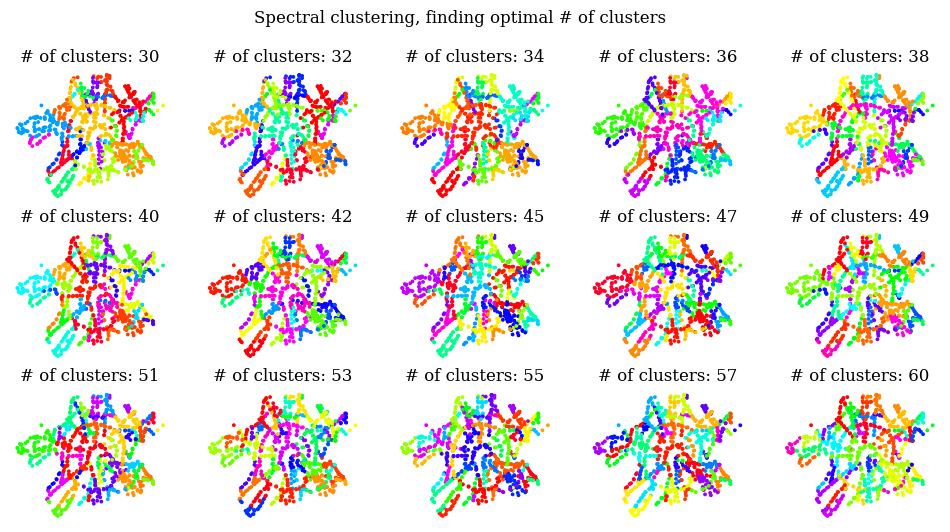

In [ ]:
n_clusters_vals = np.linspace(30, 60, 15, dtype=int)
plt.figure(figsize=(12, 6), dpi=100)
plt.suptitle('Spectral clustering, finding optimal # of clusters')
for i in range(3):
    for j in range(5):
        n_clusters = n_clusters_vals[i * 5 + j]
        model = GraphClustering(n_clusters=n_clusters)
        y = model.fit_predict(adjacency_matrix)
        plt.subplot(3, 5, i * 5 + j + 1)
        plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=y, s=3)
        plt.axis('off')
        plt.title(f'# of clusters: {n_clusters}')

<font color=blue>Ну теперь-то очевидно, что нам нужно 42 кластера.</font>

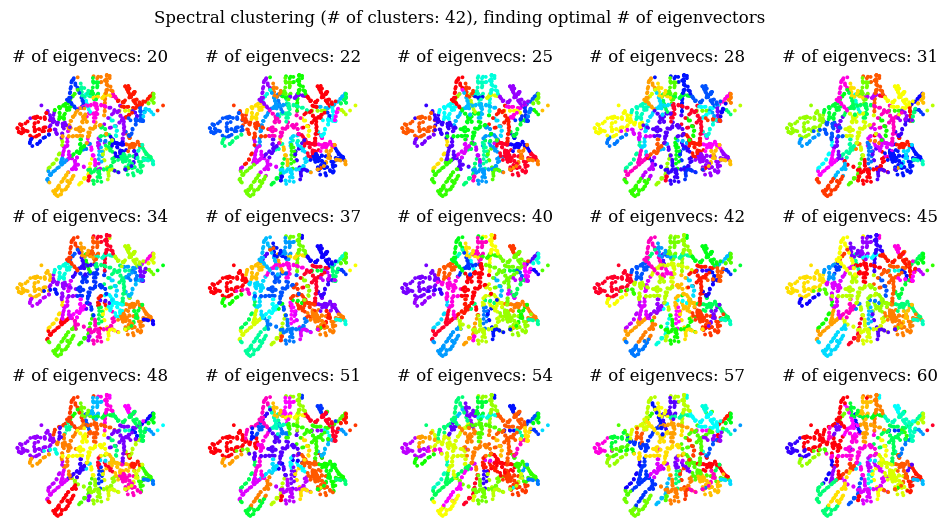

In [ ]:
n_components_vals = np.linspace(20, 60, 15, dtype=int)
plt.figure(figsize=(12, 6), dpi=100)
plt.suptitle('Spectral clustering (# of clusters: 42), '
             'finding optimal # of eigenvectors')
for i in range(3):
    for j in range(5):
        n_components = n_components_vals[i * 5 + j]
        model = GraphClustering(n_clusters=42,
                                n_components=n_components)
        y = model.fit_predict(adjacency_matrix)
        plt.subplot(3, 5, i * 5 + j + 1)
        plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=y, s=3)
        plt.axis('off')
        plt.title(f'# of eigenvecs: {n_components}')

<font color=blue>Как видим, качество кластеризации не очень сильно варьируется, когда используется достаточное число компонент. Результат с 45 собственными векторами достаточно адекватен:</font>

In [ ]:
y = GraphClustering(n_clusters=42, n_components=45).fit_predict(adjacency_matrix)
draw_clustered_map(data, y)

### <font color=blue>Интерпретация</font>

**Ваш ответ здесь:**

<b>Чем отличаются разбиения на кластеры, получаемые разными алгоритмами?</b>

<font color=blue>KMeans выдает шарообразные кучки примерно одинакового размера. С DBSCAN получаются более сложные формы, число объектов в кластере сильно разное. Также в данном методе отдельно выделяются шумовые точки. Спектральная кластеризация выдает формы, наиболее похожие на маршруты, пути некоторых из них пересекаются.</font>

<b>Какие плюсы и минусы есть у каждого алгоритма?</b>

<font color=blue>KMeans простой и быстрый, но его формы кластеров не подходят для данной задачи. DBSCAN уже лучше распознает близкие подряд идущие остановки, но отказывается от кластеризации некоторых точек. Спектральная кластеризация умеет разделять пересекающиеся пути и выдает наиболее адекватные формы, но алгоритмически сложнее других методов.</font>

<b>Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?</b>

<font color=blue>Для данного датасета лучше всего сработала спектральная кластеризация.</font>

-----

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [ ]:
!kaggle datasets download -d hgultekin/bbcnewsarchive --unzip -q

In [ ]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
761,entertainment,252.txt,Rock star sued by ex-girlfriend,Motley Crue guitarist Mick Mars is being sued...
729,entertainment,220.txt,New media battle for Bafta awards,The BBC leads the nominations for the Bafta I...
492,business,493.txt,China continues rapid growth,China's economy has expanded by a breakneck 9...
334,business,335.txt,Boeing secures giant Japan order,Boeing is to supply Japan Airlines with up to...
1207,politics,312.txt,Stalemate in pension strike talks,Talks aimed at averting national strikes over...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть🙈, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [ ]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [ ]:
%%time
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

CPU times: user 11.4 s, sys: 182 ms, total: 11.6 s
Wall time: 11.5 s


Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [ ]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

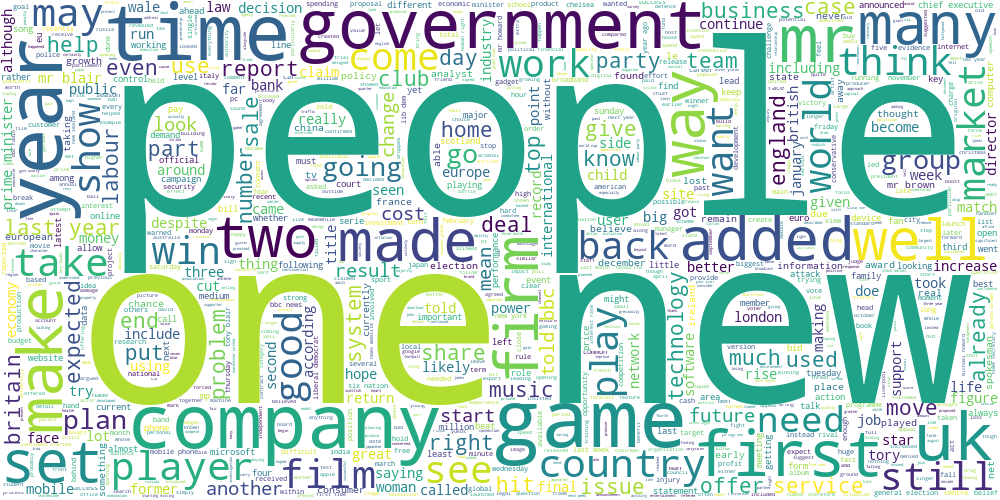

In [ ]:
draw_wordcloud(data.text)

-----

**Задание 2.1 (1 балл).** 

* **(0.5 балла)** Обучите алгоритм K-Means на tf-idf представлениях текстов. 
* **(0.25 балла)** Постройте облака тегов для текстов из разных кластеров.
* **(0.25 балла)** (?) Получились ли темы интерпретируемыми? (?) Попробуйте озаглавить каждую тему.

**Подсказки:**
* Можно использовать готовую реализацию tf-idf векторайзера из sklearn
* При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова.
* Воздержитесь от использования N-грамм при обучении tf-idf.
* Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8).

**Ключевые слова:**
* *TfidfVectorizer*

### <font color=blue>Обучение KMeans</font>

In [ ]:
%%time
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans

vocab_size = 8000
tfidf = TfidfVectorizer(max_features=vocab_size)
X = tfidf.fit_transform(data.text)
n_clusters = 9
model = KMeans(n_clusters=n_clusters, random_state=0)
topics = model.fit_predict(X)

CPU times: user 3.16 s, sys: 1.39 s, total: 4.55 s
Wall time: 2.56 s


### <font color=blue>Облака и интерпретация</font>

<img src="https://upload.wikimedia.org/wikipedia/ru/3/3c/%D0%81%D0%B6%D0%B8%D0%BA_%D0%B2_%D1%82%D1%83%D0%BC%D0%B0%D0%BD%D0%B5._%D0%9F%D0%B5%D1%80%D1%81%D0%BE%D0%BD%D0%B0%D0%B6%D0%B8.jpg" width="400">

In [ ]:
names = ['Спорт 1', 'Технологии', 'Кино',
         'Бизнес', 'Музыка', 'Политика 1',
         'Спорт 2', 'Политика 2', 'Экономика']

In [ ]:
def draw_wc(texts, max_words=256, width=768, height=432, from_freqs=False):
    wordcloud = WordCloud(background_color='white',
                          max_words=max_words,
                          width=width, height=height)
    if from_freqs:
        wordcloud.generate_from_frequencies(texts)
    else:
        joint_texts = ' '.join(list(texts))
        wordcloud.generate(joint_texts)
    return wordcloud.to_image()

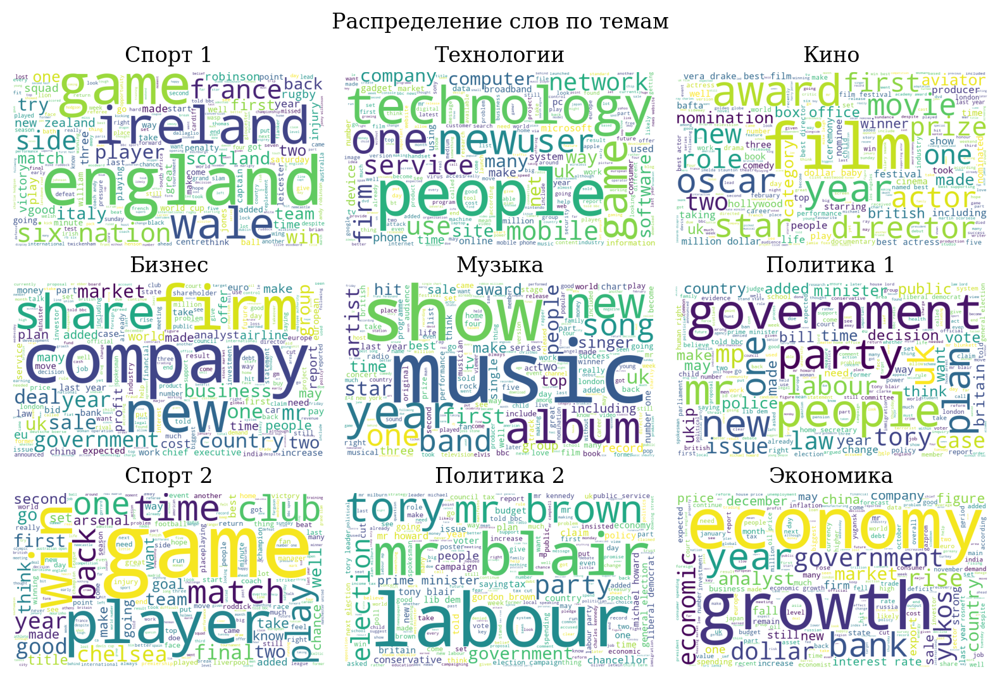

In [ ]:
plt.figure(figsize=(8, 5.2), dpi=200)
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.title(names[i])
    plt.axis('off')
    img = draw_wc(data.text[topics == i])
    plt.imshow(img)
plt.suptitle('Распределение слов по темам', y=1.03)
plt.tight_layout()

**Ваш ответ здесь:**

<font color=blue>Возможные названия тем даны выше, над облаками. Темы получились вполне интерпретируемыми, но есть похожие пары — две темы о спорте и две темы о политике. В силу недетерменированности KMeans при других сидах могут быть и другие разбиения (например, два топика о технологиях). Можно выделить и особенности подгрупп: «Спорт 2» преимущественно о футболе, «Политика 2» — о Парламенте Великобритании.</font>

-----

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. 

* **(0.3 балла)** Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков tf-idf максимальны.
* **(0.2 балла)** (?) Согласуются ли полученные слова с облаками тегов из прошлого задания?

<font color=blue>Построим облака для центров кластеров, всях в качестве весов tfidf-представления этих объектов:</font>

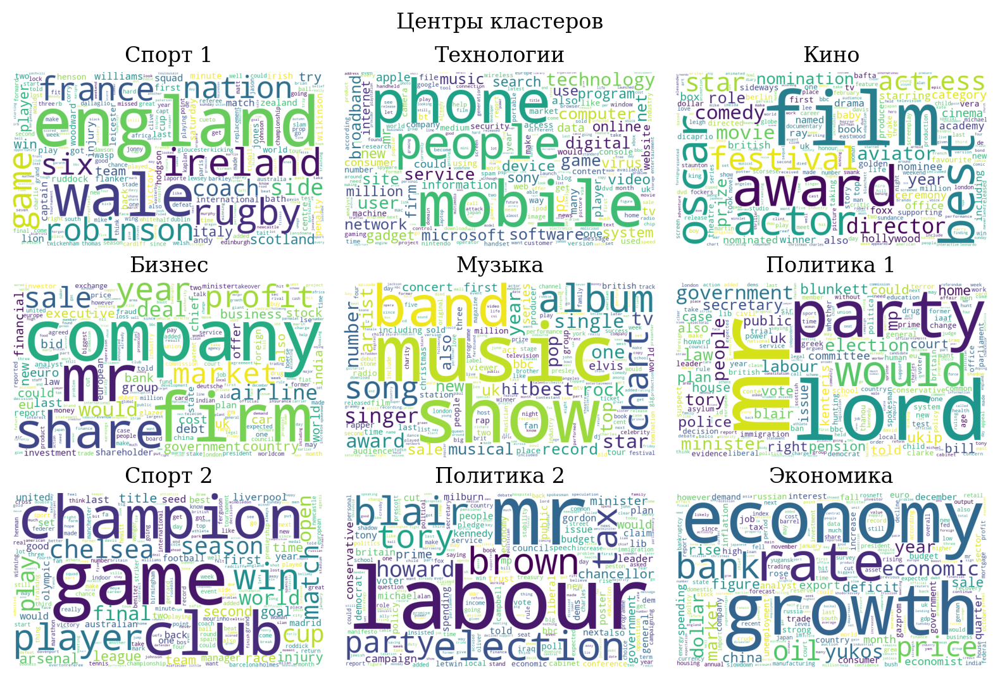

In [ ]:
ind2word = tfidf.get_feature_names()

plt.figure(figsize=(8, 5.2), dpi=200)
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.title(names[i])
    plt.axis('off')
    img = draw_wc(dict(zip(ind2word, model.cluster_centers_[i])),
                  from_freqs=True)
    plt.imshow(img)
plt.suptitle('Центры кластеров', y=1.03)
plt.tight_layout()

**Ваш ответ здесь:**

<font color=blue>Если сравнить построенные облака для всех документов из темы и для центроидов, то несложно заметить, что они очень похожи. Причем наборы слов в последнем случае легче отделимы друг от друга в смежных темах. Никто не просил, но заметим, что в некоторых облаках (например, «Политика 1» и «Политика 2» один из наибольших весов имеет терм "Mr"), и для центров такой bias еще более выражен.</font>

-----

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). 

* п.1 Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации. 
 * **(0.3 балла)** При этом для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров;
 * **(0.5 балла)** Подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.
* п.2 **(0.5 балла)** Обучите двухмерные t-SNE ([Почитать можно тут, часть 2](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture11-unsupervised.pdf), а также посмотреть непосредственно в [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)) представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом.
* п.3 **(0.2 балла)** (?) Прокомментируйте получившиеся результаты. (?) Какой баланс кластеров получился у разных методов? (?) Соотносятся ли визуализации для текстов с визуализациями для географических данных?


**Замечания:**
* В этом задании используйте реализации спектральной кластеризации и t-SNE из `sklearn`
* В п.2 Лучше всего расположить визуализации на одном графике на трех разных сабплотах. 

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

### <font color=blue>KMeans, DBSCAN, SC</font>

<font color=blue>Разбиение для KMeans мы уже получили, будем заносить все результаты в словарь:</font>

In [ ]:
cluster_topics = {'KMeans': topics}

<font color=blue>Теперь обучим DBSCAN:</font>

In [ ]:
from sklearn.cluster import DBSCAN

topics = DBSCAN().fit_predict(X)
np.unique(topics)

array([-1])

<font color=blue>ヾ( ￣O￣)ツ</font>

In [ ]:
from tqdm import tqdm

epsilons = np.linspace(0.5, 1.5, 100)
n_clusters_dbscan = []
noise_fraq = []

for eps in tqdm(epsilons):
    topics = DBSCAN(eps=eps).fit_predict(X)
    n_topics = (np.unique(topics) != -1).sum()
    n_clusters_dbscan.append(n_topics)
    noise_fraq.append((topics == -1).mean())

100%|██████████| 100/100 [00:30<00:00,  3.24it/s]


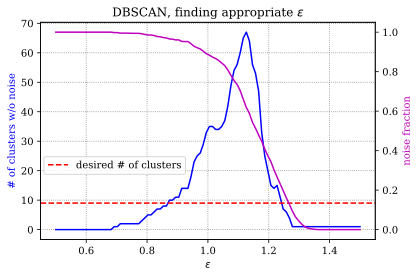

In [ ]:
set_matplotlib_formats('svg')
plt.title(r'DBSCAN, finding appropriate $\varepsilon$')
plt.xlabel(r'$\varepsilon$')

plt.plot(epsilons, n_clusters_dbscan, c='b')
plt.ylabel('# of clusters w/o noise', c='b')
plt.axhline(y=9, c='red', linestyle='--', label='desired # of clusters')
plt.legend(loc=(0.01, 0.3))

ax_sec = plt.gca().twinx()
ax_sec.plot(epsilons, noise_fraq, c='m')
ax_sec.set_ylabel('noise fraction', c='m')
ax_sec.set_ylim(0-0.05, 1+0.05)
ax_sec.grid(False)

<font color=blue>В принципе, график показывает особенности подбора epsilon для желаемого числа кластеров ٩(｡•́‿•̀｡)۶</font>

<font color=blue>То есть у нас есть подходящие значения с обеих сторон колокола, но в первом случае почти все объекты останутся шумовыми, поэтому следует брать $\varepsilon$ с правой стороны. Правда, даже в этом случае у DBSCAN будет другая проблема — дисбаланс (позже мы сравним баланс в разных методах).</font>

In [ ]:
topics = DBSCAN(eps=1.242).fit_predict(X)
cluster_topics['DBSCAN'] = topics
assert (np.unique(topics) != -1).sum() == n_clusters

<font color=blue>Осталось сделать спектральную кластеризацию:</font>

In [ ]:
from sklearn.cluster import SpectralClustering

# RBF kernel by default
topics = SpectralClustering(n_clusters=n_clusters, random_state=0).fit_predict(X)
cluster_topics['Spectral'] = topics

### <font color=blue>t-SNE</font>

In [ ]:
%%time
from sklearn.manifold import TSNE

tsne2d = TSNE(n_components=2, random_state=0).fit_transform(X)

CPU times: user 26.7 s, sys: 231 ms, total: 27 s
Wall time: 13.9 s


<font color=blue>Визуализируем полученные представления (убрав оси и сетку). Серым в DBSCAN, как и ранее, выделены шумовые точки.</font>

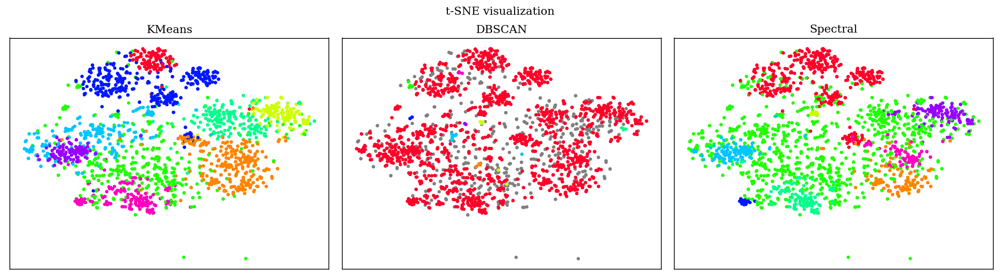

In [ ]:
set_matplotlib_formats('png')
plt.figure(figsize=(15, 4), dpi=150)
for i, (name, colors) in enumerate(cluster_topics.items(), 1):
    plt.subplot(1, 3, i)
    plt.title(name)
    plt.scatter(tsne2d[:, 0][colors == -1], tsne2d[:, 1][colors == -1],
                c='gray', s=7)
    plt.scatter(tsne2d[:, 0][colors != -1], tsne2d[:, 1][colors != -1],
                c=colors[colors != -1], s=7)
    plt.xticks([])
    plt.yticks([])
plt.suptitle('t-SNE visualization', y=1.03)
plt.tight_layout()

<font color=blue>А для KMeans мы можем даже подписать ранее выделенные темы:</font>

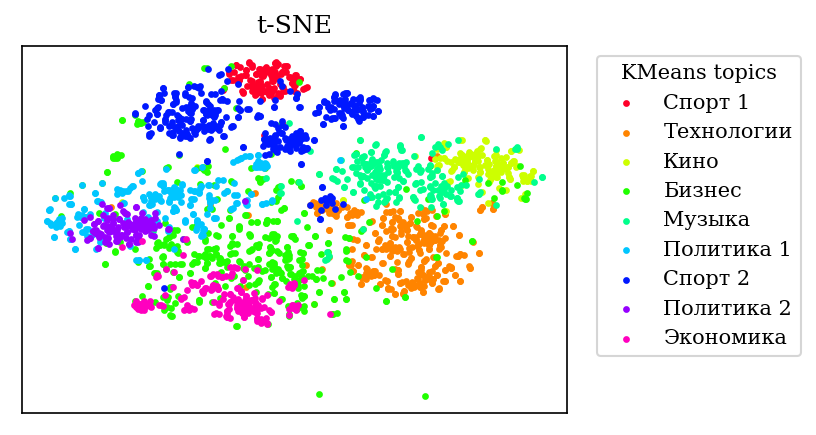

In [ ]:
plt.figure(figsize=(6, 3), dpi=150)
colors = get_cmap('gist_rainbow')(np.linspace(0, 1, n_clusters))
for c in range(n_clusters):
    mask = cluster_topics['KMeans'] == c
    plt.scatter(tsne2d[:, 0][mask], tsne2d[:, 1][mask],
                c=to_hex(colors[c]), s=5, label=names[c])
    plt.xticks([])
    plt.yticks([])
plt.title('t-SNE')
plt.legend(loc='upper right', bbox_to_anchor=(1.45, 1),
           title='KMeans topics')
plt.tight_layout()

### <font color=blue>Комментарий</font>

**Ваш ответ здесь:**

<font color=blue>В данной задаче у KMeans и спектральной кластеризации получились достаточно симпатичные результаты. Причем они похожи: в спектральной кластеризации встречаются те же кучки (например, «Кино», «Политика 2», «Экономика», а «Спорты» слились в один большой кластер). У DBSCAN явный дисбаланс: почти все приписывается одному красному кластеру. В KMeans кластеры примерно одинаковые, и в спектральной, за исключением большого оранжевого облака и маленького голубого скопления, в целом тоже. Также на графиках t-SNE заметны два выброса.</font>

-----

**Задание 2.4 (1.5 балла).** 

* **(0.5 балла)**  Обучите модель латентного размещения Дирихле (LDA).
* **(0.5 балла)**  Придумайте как превратить распределение тем для текста в номер его кластера. Опишите текстом (?) и приведите код и результаты его работы
* **(0.5 балла)** Возьмите параметр `n_components` у LDA в 2-3 раза больше, чем число кластеров для K-Means, и вновь посмотрите на темы. (?) Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Замечания:**
* Реализацию LDA во всех заданиях используйте из `sklearn` (LatentDirichletAllocation)

**Подсказка:**
* Не забудьте, что LDA работает с мешком слов, а не с tf-idf признаками.

**Ключевые слова:**
* *CountVectorizer,  LatentDirichletAllocation*

### <font color=blue>Обучаем LDA</font>

<font color=blue>Найдем два разложение с разным числом компонент: `lda_small` — совсем низкоранговое, с числом тем равным нашему стандартному числу кластеров (9), `lda_large` — в два раза больше (18).</font>

In [ ]:
%%time
from sklearn.decomposition import LatentDirichletAllocation as LDA
from sklearn.feature_extraction.text import CountVectorizer

tfreq = CountVectorizer(max_features=vocab_size).fit_transform(data.text)
lda_small = LDA(n_components=n_clusters, random_state=0)
doc_topic_small = lda_small.fit_transform(tfreq)
lda_large = LDA(n_components=n_clusters * 2, random_state=0)
doc_topic_large = lda_large.fit_transform(tfreq)

CPU times: user 29.8 s, sys: 4.4 s, total: 34.2 s
Wall time: 29.3 s


### <font color=blue>Кластеризуем</font>

<font color=blue>Поскольку на выходе мы имеем оценку распределения документов по темам, велико желание взять для каждого документа наиболее вероятную тему и объявить ее топиком. Всегда ли это разумно? 🤔 Идеально, если мы распределение для каждого документа было вырожденным: тогда кластеризация уже готова. В действительности все не так, как нам хотелось бы. Посмотрим, как распределены <u>максимальные вероятности для каждого документа:</u></font>

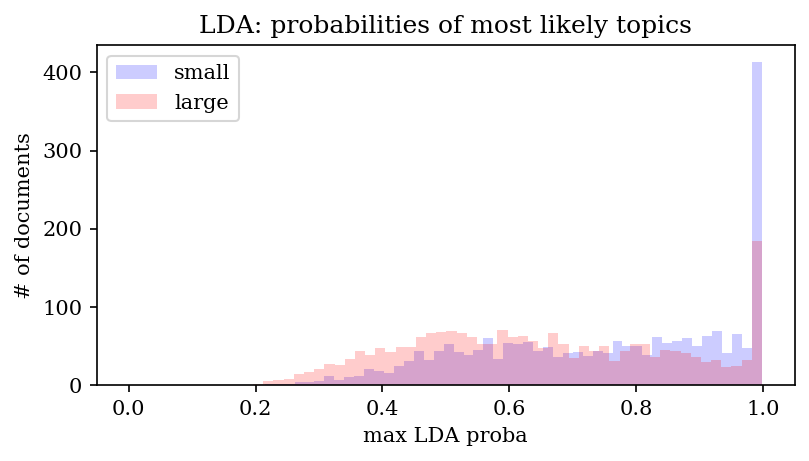

In [ ]:
set_matplotlib_formats('png')
plt.figure(figsize=(6, 3), dpi=150)
plt.title('LDA: probabilities of most likely topics')
common = {'bins': 50, 'alpha': 0.2}
plt.hist(doc_topic_small.max(axis=1), color='b', label='small', **common)
plt.hist(doc_topic_large.max(axis=1), color='r', label='large', **common)
plt.xlim(-0.05, 1.05)
plt.grid([])
plt.ylabel('# of documents')
plt.xlabel('max LDA proba')
_ = plt.legend()

<font color=blue>Гистограмма ожидаемо показывает, что с большим числом топиков главная тема документа определяется менее однозначно. Рассмотрим две стратегии: для `lda_small` обозначим наиболее вероятную тему как класс, а вот поверх над разложением `lda_large` вновь запустим кластеризацию (KMeans) с малым (9) числом тем и большим (18). Для всех трех экспериментов нарисуем облака, и раскрасим t-SNE <u>из предыдущего задания</u> в цвета полученных меток.</font>

In [ ]:
cluster_topics = {}
cluster_topics['9 LDA components, max strategy'] = doc_topic_small.argmax(axis=1)
cluster_topics[r'18 LDA components $\Rightarrow$ 9 KMeans clusters'] = KMeans(
    n_clusters=n_clusters, random_state=0).fit_predict(doc_topic_large)
cluster_topics[r'18 LDA components $\Rightarrow$ 18 KMeans clusters'] = KMeans(
    n_clusters=n_clusters * 2, random_state=0).fit_predict(doc_topic_large)

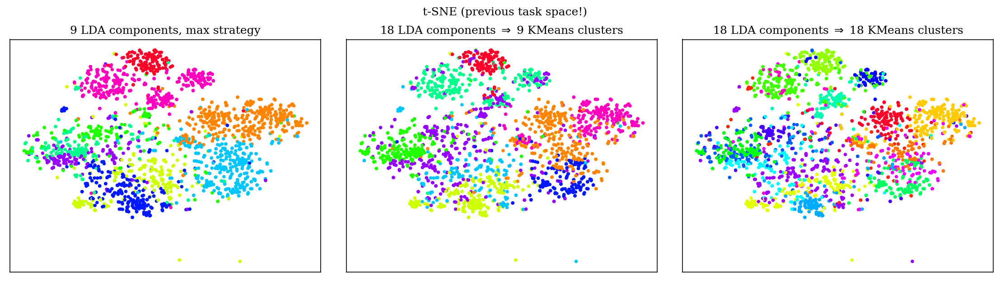

In [ ]:
plt.figure(figsize=(15, 4), dpi=150)
for i, (name, colors) in enumerate(cluster_topics.items(), 1):
    plt.subplot(1, 3, i)
    plt.title(name)
    plt.scatter(tsne2d[:, 0], tsne2d[:, 1], c=colors, s=7)
    plt.xticks([])
    plt.yticks([])
plt.suptitle('t-SNE (previous task space!)', y=1.03)
plt.tight_layout()

<font color=blue>В целом, несмотря на то что мы использовали пространство над старым TF-IDF), кучки все равно можно увидеть на всех трех графиках (причем достаточно похожие). Посмотрим теперь на облака:</font>

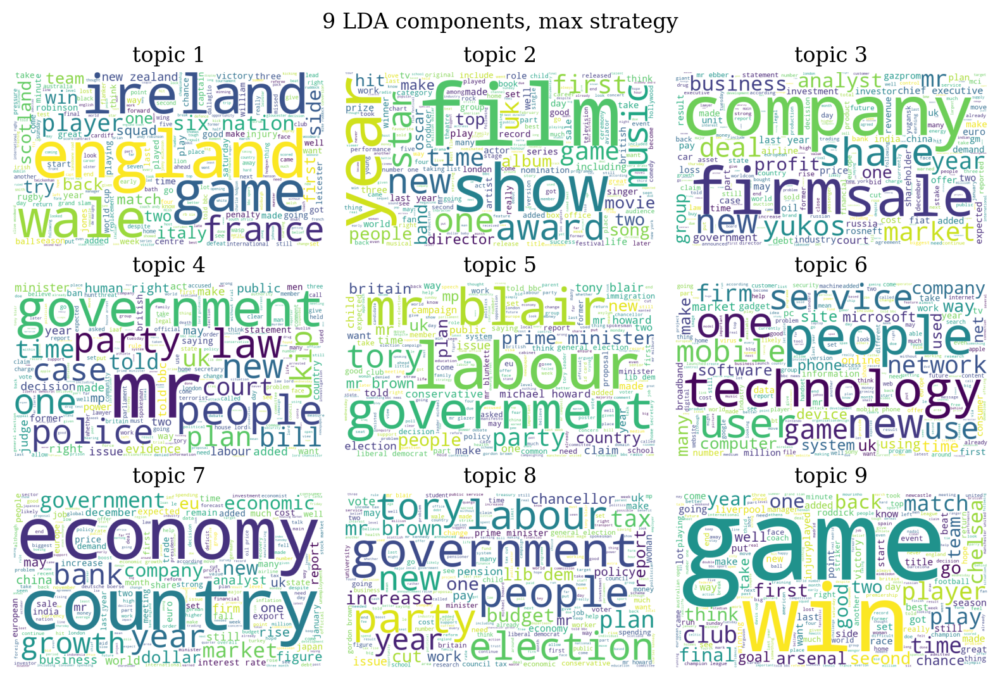

In [ ]:
name = '9 LDA components, max strategy'

plt.figure(figsize=(8, 5.2), dpi=200)
topics = cluster_topics[name]
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.title(f'topic {i + 1}')
    plt.axis('off')
    img = draw_wc(data.text[topics == i])
    plt.imshow(img)
plt.suptitle(name, y=1.03)
plt.tight_layout()

<font color=blue>Получился почти идентичный набор тем (если сравнивать с облаками первого KMeans над TF-IDF), только в другом порядке.</font>

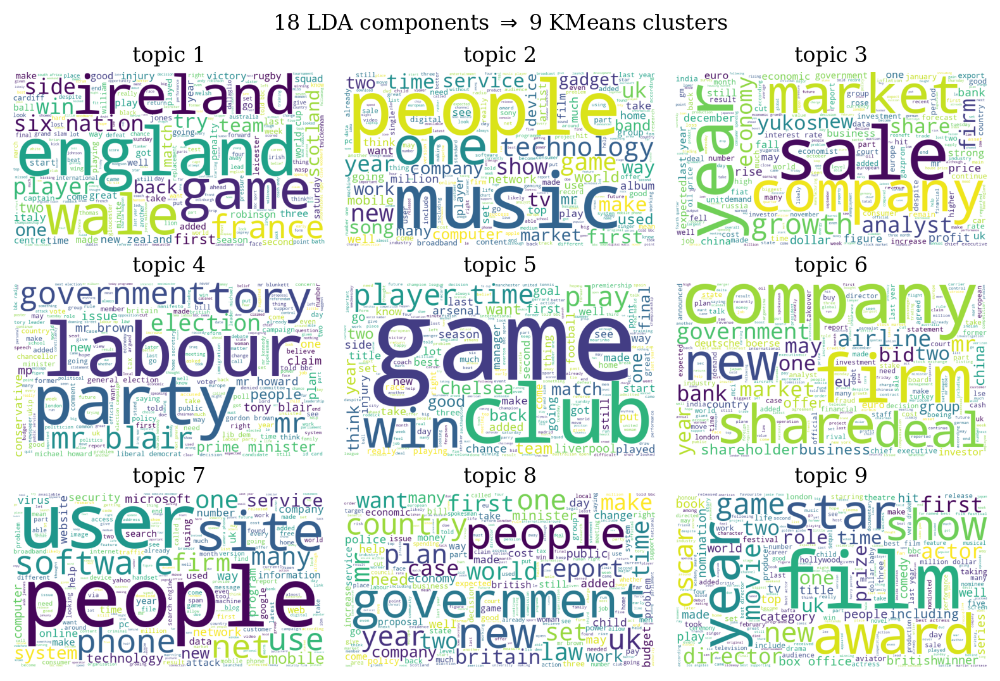

In [ ]:
name = r'18 LDA components $\Rightarrow$ 9 KMeans clusters'

plt.figure(figsize=(8, 5.2), dpi=200)
topics = cluster_topics[name]
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.title(f'topic {i + 1}')
    plt.axis('off')
    img = draw_wc(data.text[topics == i])
    plt.imshow(img)
plt.suptitle(name, y=1.03)
plt.tight_layout()

<font color=blue>Снова получаем те же основные темы (кроме порядка немного меняются слова-представители).</font>

<font color=blue>Теперь посмотрим, что с третьей стратегией — 18 тем:</font>

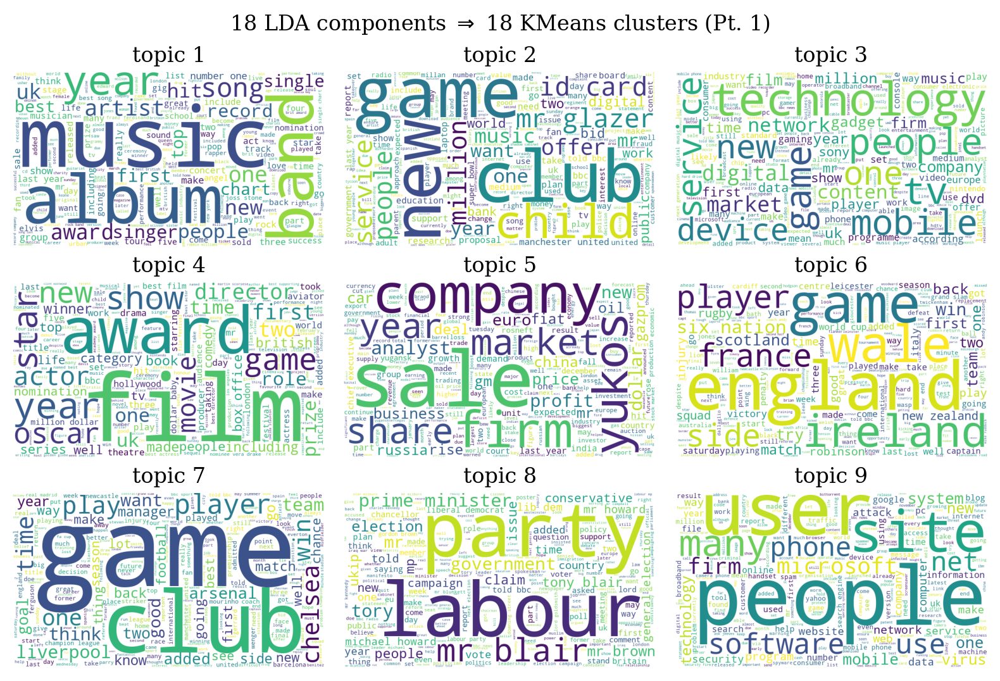

In [ ]:
name = r'18 LDA components $\Rightarrow$ 18 KMeans clusters'

plt.figure(figsize=(8, 5.2), dpi=200)
topics = cluster_topics[name]
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.title(f'topic {i + 1}')
    plt.axis('off')
    img = draw_wc(data.text[topics == i])
    plt.imshow(img)
plt.suptitle(name + ' (Pt. 1)', y=1.03)
plt.tight_layout()

<font color=blue>Теперь достаточно чисто выделилась достаточно узкие темы об интернете (topic 9), более «чистая» тема о футболе (topic 7), topic 5 как будто про бизнес Восточной Европы и Азии.</font>

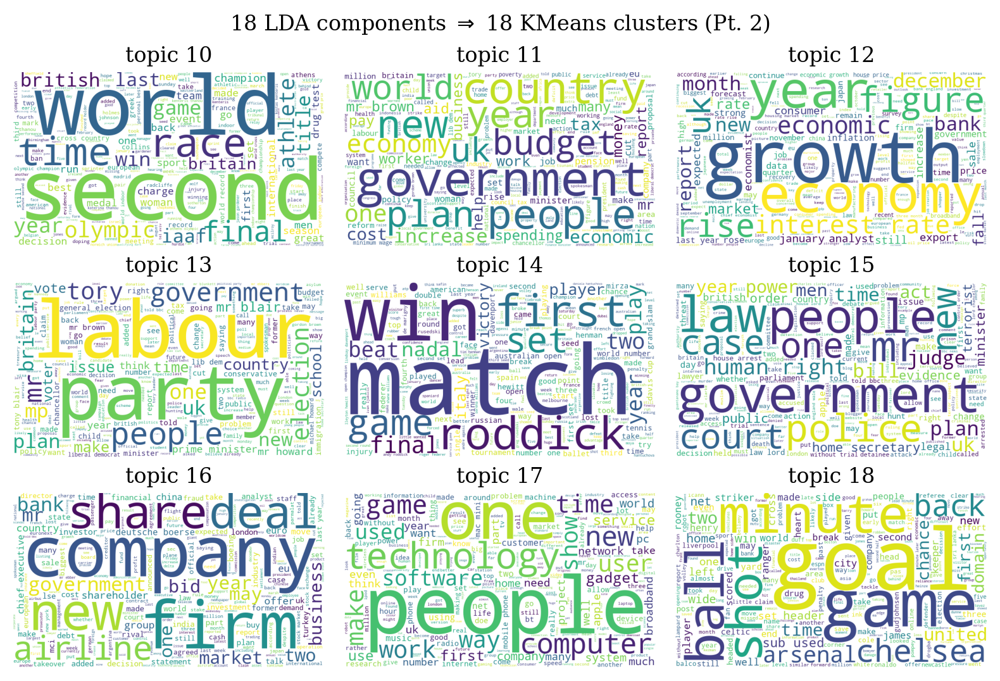

In [ ]:
name = r'18 LDA components $\Rightarrow$ 18 KMeans clusters'

plt.figure(figsize=(8, 5.2), dpi=200)
topics = cluster_topics[name]
for i in range(9):
    plt.subplot(3, 3, i + 1)
    plt.title(f'topic {9 + i + 1}')
    plt.axis('off')
    img = draw_wc(data.text[topics == 9 + i])
    plt.imshow(img)
plt.suptitle(name + ' (Pt. 2)', y=1.03)
plt.tight_layout()

<font color=blue>Выделилась и тема об Олимпиаде (topic 10), а также о праве (topic 15). Общее наблюдение — наборы слов в топиках стали менее общими, более сосредоточенными о конкретной теме. Правда, теперь у нас 5 тем о спорте.</font>

<font color=blue>ヽ(；^ ^)ノﾞ ．．．...___〇</font>

**Ваш ответ здесь:**
<font color=blue>(Все комментарии и ответы на вопросы — под соответствующими графиками)</font>

-----

## Часть 3. Transfer learning для задачи классификации текстов

**Замечание для всей части 3:**
* Для возможности получения **полного балла** accuracy всех алгоритмов на тесте должны быть не ниже 0.75, а также хотя бы один из рассмотренных в этой части алгоритмов должен достигнуть точности не менее 0.95 на тесте.

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей 🌚🌝. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

* **(0.4 балла)** Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.
* **(0.1 балла)** (?) У какой модели получилось лучшее качество? (?) С чем это связано?

**Подсказка:**
* Во второй модели расстояния до центров кластеров можно получиться при помощи метода KMeans.transform

**Ключевые слова:**
* *OrdinalEncoder, TfidfVectorizer, CountVectorizer, train_test_split, KMeans.transform*

In [ ]:
from sklearn.pipeline import make_pipeline  # Sequential
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

y, cat_names  = pd.factorize(data['category'])
print(np.unique(y, return_counts=True))

X_train, X_test, y_train, y_test = train_test_split(
    data.text, y, stratify=y, test_size=0.2, random_state=0)

(array([0, 1, 2, 3, 4]), array([510, 386, 417, 511, 401]))


In [ ]:
model_1 = make_pipeline(
    TfidfVectorizer(max_features=vocab_size),
    LogisticRegression(random_state=0)
)

model_2_raw = make_pipeline(
    TfidfVectorizer(max_features=vocab_size),
    KMeans(random_state=0),
    # StandardScaler(),  # (!)
    LogisticRegression(random_state=0)
)

model_2_normalized = make_pipeline(
    TfidfVectorizer(max_features=vocab_size),
    KMeans(random_state=0),
    StandardScaler(),  # (!)
    LogisticRegression(random_state=0)
)

model_3 = make_pipeline(
    CountVectorizer(max_features=vocab_size),
    LDA(random_state=0),
    LogisticRegression(random_state=0)
)

models = [model_1, model_2_raw, model_2_normalized, model_3]

model_names = ['TF-IDF -> LogReg',
               'TF-IDF -> KMeans -> LogReg',
                'TF-IDF -> KMeans -> Normalization -> LogReg',
               'LDA -> LogReg']

In [ ]:
name_len = 75

for name, model in zip(model_names, models):
    pad = (name_len - len(name)) // 2
    print('=' * pad, name, '=' * (name_len - pad - len(name)))
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    acc = (y_pred == y_test).mean()
    print(f'accuracy = {acc:.4f}')
    print('=' * (name_len + 2), end='\n\n')

============================= TF-IDF -> LogReg ==============================
accuracy = 0.9775

======================== TF-IDF -> KMeans -> LogReg =========================


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:765: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


accuracy = 0.8719

================ TF-IDF -> KMeans -> Normalization -> LogReg ================
accuracy = 0.9663

=============================== LDA -> LogReg ===============================
accuracy = 0.9461



<font color=blue>\\(★ω★)/</font>

**Ваш ответ здесь:**

<font color=blue>Итак, худший результат у второй стратегии, где на вход логистической регрессии подаются расстояния до центров кластеров. На самом деле этот подход достаточно не устойчив: при перезапусках с другими сидами качество может сильно измениться, а логрегрессия может не сойтись. Можно увеличить число итераций, но более простое решение — нормализация расстояний до кластеров. Как видим, в этом случае получается высокое качество. </font>

<font color=blue>LDA дает достаточно неплохе новое признаковое пространство (причем в одной шкале, что хорошо для логрегрессии) — accuracy тоже близко к лучшему.</font>

<font color=blue>Первый вариант дал самый хороший результат — 0.9775. Вообще, линейная модель над TF-IDF — один из бейзлайновых подходов для классификации текстов. SVM, например, покажет примерно то же качество:</font>

In [ ]:
from sklearn.svm import LinearSVC

model_4 = make_pipeline(
    TfidfVectorizer(max_features=vocab_size),
    LinearSVC(random_state=0)
)
model_4.fit(X_train, y_train)
(model_4.predict(X_test) == y_test).mean()

0.9752808988764045

<font color=blue>Дело в том, что TF-IDF дает действительно неплохие признаки для таких текстов, причем размерность выборки получается достаточно высокой, чтобы классы могли быть в целом линейно разделимыми. Стратегия с расстояниями до центров из KMeans плоха при отсутствии нормализации (не сходится, так еще и качество наихудшее), а с нормализацией лучше подхода с LDA.</font>

-----

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры (tf-idf, bag_of_words) и алгоритмы кластеризации (KMeans)) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%).

* **(1.2 балла)** Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 
* **(0.3 балла)** (?) Как изменились результаты по сравнению с обучением на полной разметке? (?) Сделайте выводы.

**Пояснение:**
* Тестовую выборку возьмите из задания 3.1. А разделять надо тренировочную из 3.1
* Обучаете векторайзер на 70%, применяете векторайзер к 5%, и на этих 5% уже обучаете классификатор.
* Итак, берем 3 варианта обучения из задания 3.1. Вы должны:
 * 1-я модель. Подобрать оптимальный гиперпараметр С у LogisticRegression на tf-idf признаках. Выбираем оптимальный параметр по валидационной выборке. Далее оцениваем обученную модель с оптимальном параметром на тесте.
 * 2-я модель. Шаг 1. Подобрать оптимальный гиперпараметр n_clusters у KMeans на tf-idf признаках: перебираем значения n_clusters и при каждом значении обучаем LogisticRegression на дефолтных параметрах (быть может с ограничением max_iter, об этом ниже). То есть классификатор в данном случае будет на одинаковых параметрах для всех представителей семейства алгоритмов KMeans. Далее выбираете оптимальный n_clusters по качеству классификатора на валидационной выборке. Шаг 2. Обучаете KMeans с оптимальным n_clusters и перебираете значение C у LogisticRegression. Также выбираете оптмальное по валидации. И только после двух подобранных оптимальных параметров выводите качество на тесте.
 * 3-я модель. Аналогично второй, только вместо KMeans --- LatentDirichletAllocation, а вместо tf-idf -- bag of words.

**Замечания:**
* Параметр $С$ у LogisticRegression перебирайте *по логарифмической сетке.* Обратите внимание, что $С$ НЕ перед регуляризатором, поэтому, скорее всего, наиболее оптимальными будут большие значения $C$. **Для возможности получения полного балла** переберите хотя бы 20 параметров, и затроньте значения в 1e-2 и 1e6 (по большей части значения должны лежать в этом отрезке)
* **Для возможности получения полного балла** параметр n_clusters у KMeans при переборе должен затрагивать значения в 10 и 1000 кластеров (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не менее 20 значений кластеров *(по линейной сетке)*
* **Для возможности получения полного балла** параметр n_components у LDA при переборе должен затрагивать значения в 5 и 14 (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не меньше 10 различных значений *(по линейной сетке)*

**Подсказка:**
* Может быть для ограничения времени обучения лучше будет ограничить параметр max_iter в LogisticRegression, равным, например, 1000

### <font color=blue>Подготовка данных, преобразование текстовых признаков</font>

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train, stratify=y_train, test_size=0.3, random_state=0)

X_train_lab, X_train_unlab, y_train_lab, _ = train_test_split(
    X_train, y_train, stratify=y_train, test_size=65/70, random_state=0)

tfidf = TfidfVectorizer(max_features=vocab_size)
X_train_tfidf = tfidf.fit_transform(X_train)
X_train_lab_tfidf = tfidf.transform(X_train_lab)
X_val_tfidf = tfidf.transform(X_val)
X_test_tfidf = tfidf.transform(X_test)

tf = CountVectorizer(max_features=vocab_size)
X_train_tf = tf.fit_transform(X_train)
X_train_lab_tf = tf.transform(X_train_lab)
X_val_tf = tf.transform(X_val)
X_test_tf = tf.transform(X_test)

### <font color=blue>Перебор сетки гиперпараметров по инструкции (∩ᄑ_ᄑ)/ ♫•*¨*•.¸¸♪</font>

In [ ]:
print('== Model 1 ==\n')
Cs = np.logspace(-3, 7, 21)
best_model = None
best_acc = -1

for C in Cs:
    model = LogisticRegression(random_state=0, C=C)
    model.fit(X_train_lab_tfidf, y_train_lab)
    y_pred = model.predict(X_val_tfidf)
    acc = (y_pred == y_val).mean()
    print(f'C = {C:12.3f},  accuracy (val): {acc:.4f}')
    if acc > best_acc:
        best_acc = acc
        best_model = model

print('\n', '=' * 9, '\n')
acc = (best_model.predict(X_test_tfidf) == y_test).mean()
print(f'best C = {best_model.C:.3f},  accuracy (test): {acc:.4f}')

== Model 1 ==

C =        0.001,  accuracy (val): 0.4588
C =        0.003,  accuracy (val): 0.4588
C =        0.010,  accuracy (val): 0.4588
C =        0.032,  accuracy (val): 0.4588
C =        0.100,  accuracy (val): 0.4644
C =        0.316,  accuracy (val): 0.6629
C =        1.000,  accuracy (val): 0.8184
C =        3.162,  accuracy (val): 0.8483
C =       10.000,  accuracy (val): 0.8614
C =       31.623,  accuracy (val): 0.8708
C =      100.000,  accuracy (val): 0.8745
C =      316.228,  accuracy (val): 0.8745
C =     1000.000,  accuracy (val): 0.8801
C =     3162.278,  accuracy (val): 0.8858
C =    10000.000,  accuracy (val): 0.8858
C =    31622.777,  accuracy (val): 0.8858
C =   100000.000,  accuracy (val): 0.8820
C =   316227.766,  accuracy (val): 0.8745
C =  1000000.000,  accuracy (val): 0.8727
C =  3162277.660,  accuracy (val): 0.8670
C = 10000000.000,  accuracy (val): 0.8633


best C = 3162.278,  accuracy (test): 0.9124


In [ ]:
print('== Model 2, Pt.1 ==\n')
n_clusterss = np.linspace(10, 1000, 20, dtype=int)
best_kmeans = None
best_acc = -1

for n_clusters in n_clusterss:
    kmeans = KMeans(random_state=0, n_clusters=n_clusters)
    train_features = kmeans.fit(X_train_tfidf).transform(X_train_lab_tfidf)
    val_features = kmeans.transform(X_val_tfidf)

    model = LogisticRegression(random_state=0, max_iter=3000)
    model.fit(train_features, y_train_lab)
    y_pred = model.predict(val_features)
    acc = (y_pred == y_val).mean()
    print(f'n_clusters = {n_clusters:2},  accuracy (val): {acc:.4f}')
    if acc > best_acc:
        best_acc = acc
        best_kmeans = kmeans

X_train_lab_kmeans = best_kmeans.transform(X_train_lab_tfidf)
X_val_kmeans = best_kmeans.transform(X_val_tfidf)
X_test_kmeans = best_kmeans.transform(X_test_tfidf)

print('\n', '=' * 9, '\n')
print(f'best n_clusters = {best_kmeans.n_clusters}')

== Model 2, Pt.1 ==

n_clusters = 10,  accuracy (val): 0.4663
n_clusters = 62,  accuracy (val): 0.7697
n_clusters = 114,  accuracy (val): 0.8165
n_clusters = 166,  accuracy (val): 0.8446
n_clusters = 218,  accuracy (val): 0.8670
n_clusters = 270,  accuracy (val): 0.8708
n_clusters = 322,  accuracy (val): 0.8951
n_clusters = 374,  accuracy (val): 0.8839
n_clusters = 426,  accuracy (val): 0.8914
n_clusters = 478,  accuracy (val): 0.8951
n_clusters = 531,  accuracy (val): 0.8970
n_clusters = 583,  accuracy (val): 0.9045
n_clusters = 635,  accuracy (val): 0.8970
n_clusters = 687,  accuracy (val): 0.8895
n_clusters = 739,  accuracy (val): 0.8951
n_clusters = 791,  accuracy (val): 0.8989
n_clusters = 843,  accuracy (val): 0.8970
n_clusters = 895,  accuracy (val): 0.8970
n_clusters = 947,  accuracy (val): 0.8914
n_clusters = 1000,  accuracy (val): 0.8933


best n_clusters = 583


In [ ]:
print('== Model 2, Pt. 2 ==\n')
Cs = np.logspace(-3, 7, 21)
best_model = None
best_acc = -1

for C in Cs:
    model = LogisticRegression(random_state=0, C=C, max_iter=3000)
    model.fit(X_train_lab_kmeans, y_train_lab)
    y_pred = model.predict(X_val_kmeans)
    acc = (y_pred == y_val).mean()
    print(f'C = {C:12.3f},  accuracy (val): {acc:.4f}')
    if acc > best_acc:
        best_acc = acc
        best_model = model

print('\n', '=' * 9, '\n')
acc = (best_model.predict(X_test_kmeans) == y_test).mean()
print(f'best C = {best_model.C:.3f},  accuracy (test): {acc:.4f}')

== Model 2, Pt. 2 ==

C =        0.001,  accuracy (val): 0.4588
C =        0.003,  accuracy (val): 0.4588
C =        0.010,  accuracy (val): 0.4588
C =        0.032,  accuracy (val): 0.4625
C =        0.100,  accuracy (val): 0.6311
C =        0.316,  accuracy (val): 0.8315
C =        1.000,  accuracy (val): 0.9045
C =        3.162,  accuracy (val): 0.9120
C =       10.000,  accuracy (val): 0.9213
C =       31.623,  accuracy (val): 0.9232
C =      100.000,  accuracy (val): 0.9326
C =      316.228,  accuracy (val): 0.9307
C =     1000.000,  accuracy (val): 0.9270
C =     3162.278,  accuracy (val): 0.9251
C =    10000.000,  accuracy (val): 0.9251
C =    31622.777,  accuracy (val): 0.9270
C =   100000.000,  accuracy (val): 0.9232
C =   316227.766,  accuracy (val): 0.9270
C =  1000000.000,  accuracy (val): 0.9307
C =  3162277.660,  accuracy (val): 0.8933
C = 10000000.000,  accuracy (val): 0.8783


best C = 100.000,  accuracy (test): 0.9618


In [ ]:
print('== Model 3, Pt.1 ==\n')
n_componentss = np.arange(4, 20)
best_lda = None
best_acc = -1

for n_components in n_componentss:
    lda = LDA(random_state=0, n_components=n_components)
    train_features = lda.fit(X_train_tf).transform(X_train_lab_tf)
    val_features = lda.transform(X_val_tf)

    model = LogisticRegression(random_state=0, max_iter=3000)
    model.fit(train_features, y_train_lab)
    y_pred = model.predict(val_features)
    acc = (y_pred == y_val).mean()
    print(f'n_components = {n_components:2},  accuracy (val): {acc:.4f}')
    if acc > best_acc:
        best_acc = acc
        best_lda = lda

X_train_lab_lda = best_lda.transform(X_train_lab_tf)
X_val_lda = best_lda.transform(X_val_tf)
X_test_lda = best_lda.transform(X_test_tf)

print('\n', '=' * 9, '\n')
print(f'best n_components = {best_lda.n_components}')

== Model 3, Pt.1 ==

n_components =  4,  accuracy (val): 0.6910
n_components =  5,  accuracy (val): 0.8090
n_components =  6,  accuracy (val): 0.8839
n_components =  7,  accuracy (val): 0.9045
n_components =  8,  accuracy (val): 0.8970
n_components =  9,  accuracy (val): 0.9082
n_components = 10,  accuracy (val): 0.8951
n_components = 11,  accuracy (val): 0.8989
n_components = 12,  accuracy (val): 0.9007
n_components = 13,  accuracy (val): 0.9064
n_components = 14,  accuracy (val): 0.9045
n_components = 15,  accuracy (val): 0.9120
n_components = 16,  accuracy (val): 0.9007
n_components = 17,  accuracy (val): 0.9082
n_components = 18,  accuracy (val): 0.9064
n_components = 19,  accuracy (val): 0.9026


best n_components = 15


In [ ]:
print('== Model 3, Pt. 2 ==\n')
Cs = np.logspace(-3, 7, 21)
best_model = None
best_acc = -1

for C in Cs:
    model = LogisticRegression(random_state=0, C=C, max_iter=3000)
    model.fit(X_train_lab_lda, y_train_lab)
    y_pred = model.predict(X_val_lda)
    acc = (y_pred == y_val).mean()
    print(f'C = {C:12.3f},  accuracy (val): {acc:.4f}')
    if acc > best_acc:
        best_acc = acc
        best_model = model

print('\n', '=' * 9, '\n')
acc = (best_model.predict(X_test_lda) == y_test).mean()
print(f'best C = {best_model.C:.3f},  accuracy (test): {acc:.4f}')

== Model 3, Pt. 2 ==

C =        0.001,  accuracy (val): 0.4551
C =        0.003,  accuracy (val): 0.4551
C =        0.010,  accuracy (val): 0.4551
C =        0.032,  accuracy (val): 0.4757
C =        0.100,  accuracy (val): 0.7659
C =        0.316,  accuracy (val): 0.8895
C =        1.000,  accuracy (val): 0.9120
C =        3.162,  accuracy (val): 0.9232
C =       10.000,  accuracy (val): 0.9382
C =       31.623,  accuracy (val): 0.9345
C =      100.000,  accuracy (val): 0.9307
C =      316.228,  accuracy (val): 0.9270
C =     1000.000,  accuracy (val): 0.9251
C =     3162.278,  accuracy (val): 0.9176
C =    10000.000,  accuracy (val): 0.9157
C =    31622.777,  accuracy (val): 0.9139
C =   100000.000,  accuracy (val): 0.9101
C =   316227.766,  accuracy (val): 0.9101
C =  1000000.000,  accuracy (val): 0.9157
C =  3162277.660,  accuracy (val): 0.9288
C = 10000000.000,  accuracy (val): 0.9251


best C = 10.000,  accuracy (test): 0.9393


**Ваш ответ здесь:**

<font color=blue>С предложенным подбором гиперпараметров наилучший результат у второго подхода (расстояния до кластеров KMeans), в то время как в предыдущем задании он был наихудшим. Первая же стратегия (просто TF-IDF) при таком маленьком числе размеченных данных показала себя хуже всего, при этом обучается быстрее всего. Подход с LDA по-прежнему «средний». </font>

<font color=blue>Данные эксперименты продемонстрировали, что semi-supervised методы могут справляться так же неплохо, как и привычное обучение на полностью размеченном датасете.</font>

-----

## Бонус

**Задание 4 (1 балл)**. 

* **(Максимум 0.8 балла, 0.4 балла за каждый исследованный метод)** Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. 
* **(0.2 балла)** (?) Получилось ли добиться лучшего качества? (?) Сделайте выводы.

<font color=blue>Попробуем с помощью неразмеченных данных улучшить классификацию над TF-IDF, построенным на всей обучающей выборке (размеченной и неразмеченной частях — все сохраняется с предыдущего задания). Для начала от разреженных матриц перейдем к плотным (требуется для semi-supervised алгоритмов sklearn), неразмеченные метки в обучающей выборке обозначим `-1`.</font>

In [ ]:
from scipy.sparse import vstack

features_train = vstack([X_train_lab_tfidf,
                         tfidf.transform(X_train_unlab)]).toarray()
features_val = X_val_tfidf
features_test = X_test_tfidf.toarray()

labels_train = np.hstack([y_train_lab,
                          np.full(len(X_train_unlab), -1, dtype=int)])
labels_test = y_test
labels_val = y_val

<font color=blue>В качестве бейзлайна возьмем логрегрессию с подобранным коэффициентом регуляризации. Обучаться модель будет только на размеченной части трейна:</font>

In [ ]:
model = LogisticRegression(C=1e4, random_state=0)
model.fit(X_train_lab_tfidf, y_train_lab)
acc = (y_test == model.predict(X_test_tfidf)).mean()
print(f'Baseline accuracy: {acc:.4f}')

Baseline accuracy: 0.9169


<font color=blue>Это достаточно сильная модель, несмотря на маленькую обучающую выборку. Посмотрим, можно ли улучшить результат встроенными в sklearn средствами.</font>

<font color=blue>В качестве первого semi-supervised метода возьмем label-spreading. Внутри него строится полный граф, вершины которого — объекты выборки, а веса между ними тем больше, чем ближе объекты (то же самое делается при спектральной кластеризации). Каждой вершине предписывается распределение по возможным меткам (soft labels) эти распределения пересчитываются итеративно, «распространяясь» на соседние вершины с учетом весов, до сходимости.</font>

<font color=blue>В качестве ядра возьмем RBF, тогда у нас будет два основных параметра: $\alpha$ — отвечает за степень влияния соседних вершин на рассматриваемую и $\gamma$ — параметр RBF-ядра.</font>

<font color=blue>Найдем оптимальные параметры:</font>

In [ ]:
from sklearn.semi_supervised import LabelSpreading

alphas = np.linspace(0.1, 0.9, 9)
accs_alpha = []

for alpha in tqdm(alphas):
    model = LabelSpreading(kernel='rbf', alpha=alpha, max_iter=200)
    model.fit(features_train, labels_train)
    preds = model.predict(features_val)
    accs_alpha.append((labels_val == preds).mean())

idx_alpha = np.argmax(accs_alpha)

gammas = np.linspace(10, 30, 10)
accs_gamma = []

for gamma in tqdm(gammas):
    model = LabelSpreading(kernel='rbf', max_iter=200,
                                  alpha=alphas[idx_alpha],
                                  gamma=gamma)
    model.fit(features_train, labels_train)
    preds = model.predict(features_val)
    accs_gamma.append((labels_val == preds).mean())

idx_gamma = np.argmax(accs_gamma)

100%|██████████| 10/10 [00:06<00:00,  1.63it/s]


<font color=blue>Удостоверимся, что $\alpha$ и $\gamma$ найдены корректно:</font>

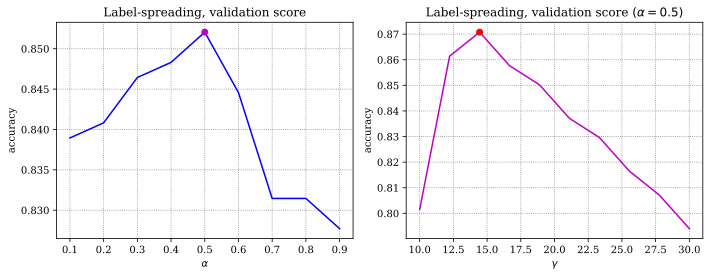

In [ ]:
set_matplotlib_formats('svg')
plt.figure(figsize=(10, 4))

plt.subplot(121)
plt.plot(alphas, accs_alpha)
plt.scatter(alphas[idx_alpha], accs_alpha[idx_alpha], color='m', zorder=10)
plt.title('Label-spreading, validation score')
plt.xlabel(r'$\alpha$')
plt.ylabel('accuracy')

plt.subplot(122)
plt.plot(gammas, accs_gamma, c='m')
plt.scatter(gammas[idx_gamma], accs_gamma[idx_gamma], color='r', zorder=10)
plt.title(f'Label-spreading, validation score $(\\alpha={alphas[idx_alpha]})$')
plt.xlabel(r'$\gamma$')
plt.ylabel('accuracy')

plt.tight_layout()

<font color=blue>Применим к тесту:</font>

In [ ]:
model = LabelSpreading(kernel='rbf', max_iter=200,
                       alpha=alphas[idx_alpha],
                       gamma=gammas[idx_gamma])
model.fit(features_train, labels_train)
preds = model.predict(features_test)
acc = (preds == labels_test).mean()
print(f'Label spreading test accuracy: {acc:.4f}')

Label spreading test accuracy: 0.8764


<font color=blue>Бейзлайн с логрегрессией мы не побили, но результат не так уж и плох (⁄ ⁄>⁄ ▽ ⁄<⁄ ⁄).</font>

<font color=blue>Еще, имея базовую модель, можно приписывать неразмеченным данным псевдометки (основываясь на степени уверенности модели в своем ответе). Интересно, что такой подход даже без настройки позволяет существенно улучшить качество:</font>

In [ ]:
from sklearn.semi_supervised import SelfTrainingClassifier

model = LogisticRegression(random_state=0, C=1e4, max_iter=1000)
clf = SelfTrainingClassifier(model, max_iter=3)
clf.fit(features_train, labels_train)

preds = clf.predict(features_test)
acc = (preds == labels_test).mean()
print(f'Label spreading test accuracy: {acc:.4f}')

Label spreading test accuracy: 0.9730


<font color=blue>Отметим, что данный алгоритм требует корректной оценки вероятностей (принадлежности к тому или иному классу), а логистическая регрессия как раз является хорошо откалиброванной моделью.</font>

**Задание 5 (1 балл)**. Существует метрика BCubed ([Ссылка 1](https://github.com/esokolov/ml-course-hse/blob/master/2020-spring/lecture-notes/lecture17-clusterization.pdf), [Ссылка 2](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf)), которая хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). 

* **(0.2 балла)** Реализуйте подсчет метрики BCubed
* **(0.8 балла)** (?) Сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

**Замечание:**
* Пользоваться готовыми библиотечными методами для вычисления BCubed нельзя

<font color=blue>Реализуем:</font>

In [ ]:
def hmean(a, b):
    return a * b * 2 / (a + b)

def bcubed(L, C):
    '''
    Args:
        L: array of shape (n_objects,)
            True targets, «gold standard».
        C, array of shape (n_objects,)
            Predicted clustering labels.
    '''
    LL = L == L[:, None]
    CC = C == C[:, None]
    correctness = LL & CC
    precision = correctness.mean(axis=1, where=CC).mean()
    recall = correctness.mean(axis=1, where=LL).mean()
    return hmean(precision, recall)

<font color=blue>Воспроизведем несколько использованных моделей:</font>

In [ ]:
n_clusters = len(np.unique(y))

models = {
    'TF-IDF -> KMeans': make_pipeline(
        TfidfVectorizer(max_features=vocab_size),
        KMeans(n_clusters=n_clusters, random_state=0)
    ),
    'TF-IDF -> Spectral Clustering': make_pipeline(
        TfidfVectorizer(max_features=vocab_size),
        SpectralClustering(n_clusters=n_clusters, random_state=0)
    ),
    'BoW -> LDA (x2 components) -> KMeans': make_pipeline(
        CountVectorizer(max_features=vocab_size),
        LDA(n_components=n_clusters * 2, random_state=0),
        KMeans(n_clusters=n_clusters)
    )
}

<font color=blue>Посчитаем:</font>

In [ ]:
name_len = 75

for name, model in models.items():
    pad = (name_len - len(name)) // 2
    print('=' * pad, name, '=' * (name_len - pad - len(name)))
    metric = bcubed(y, model.fit_predict(data.text))
    print(f'BCubed = {metric:.4f}')
    print('=' * (name_len + 2), end='\n\n')

============================= TF-IDF -> KMeans ==============================
BCubed = 0.7364

======================= TF-IDF -> Spectral Clustering =======================
BCubed = 0.6928

=================== BoW -> LDA (x2 components) -> KMeans ====================
BCubed = 0.7714



**Ваш ответ здесь:** <font color=blue>Получилось вроде неплохо. Лучше всего наконец-то сработал подход с LDA.</font>

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии🧙.

* Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). (?) Напишите, откуда брали данные и что это за данные
* **(1.7 балла)** Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое.
* **(0.3 балла)** (?) Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! 

**Подсказка:**
* Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 7 (0.05 балла)**. Опишите свои ощущения от этой домашки🥔, поощряется сравнение с предыдущей.

<font color=blue>Большой лайк за визуализации и разнообразие в заданиях, но дизлайк заданию 3.2 за перебор в заранее известном диапазоне, количестве и последовательности. Домашке по EM лайк за неочевидные алгоритмы и контест, дизлайк за долгий дебаг.</font>


In [ ]:
%%html
<iframe id="reddit-embed" src="https://www.redditmedia.com/r/memes/comments/
mlse0j/whenever_i_want_to_sound_smart_on_my_homework/
?ref_source=embed&amp;ref=share&amp;embed=true"
sandbox="allow-scripts allow-same-origin allow-popups"
scrolling="no" width="640" height="508"></iframe>